In [17]:
import torch
from PIL import Image
from sklearn.model_selection import train_test_split
from torch import nn
from torch import optim
import torch.nn.functional as F
import torchvision.transforms.functional as transF
import numpy as np
from torch.utils.data import DataLoader, Dataset
from torchvision import datasets, transforms, models
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
from tqdm.notebook import tqdm
import math

In [18]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cpu


In [19]:
class SquarePad:
    def __call__(self, image):
        max_wh = max(image.size)
        p_left, p_top = [(max_wh - s) // 2 for s in image.size]
        p_right, p_bottom = [max_wh - (s+pad) for s, pad in zip(image.size, [p_left, p_top])]
        padding = (p_left, p_top, p_right, p_bottom)
        return transF.pad(image, padding, 0, 'constant')

In [20]:
test_transform = transforms.Compose([
                                      SquarePad(),
                                      transforms.Resize((330, 330)),
                                      transforms.ToTensor(),
                                      transforms.Normalize([0.3909, 0.3764, 0.3076], 
                                                           [0.3262, 0.3165, 0.3023])
                                      ])


In [21]:
test_path = "images"
test_image = datasets.ImageFolder(test_path, transform=test_transform)
class_name = test_image.classes
print(class_name)

['Butterfly', 'Chicken', 'Horse', 'Lizard', 'Spider']


In [22]:
batch_size=54
test_loader = torch.utils.data.DataLoader(test_image, batch_size=batch_size, shuffle=True)
number_test_image = len(test_image)
print(number_test_image)

54


In [23]:
class BasicBlock(nn.Module):
    expansion = 1

    def __init__(self, inplanes, planes, stride=1, downsample=None):
        super().__init__()
        self.conv1 = nn.Conv2d(inplanes, planes, kernel_size=3, stride=stride,
                     padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(planes)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = nn.Conv2d(planes, planes, kernel_size=3, stride=1,
                     padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(planes)
        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        identity = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        out = self.bn2(out)

        if self.downsample is not None:
            identity = self.downsample(x)

        out += identity
        out = self.relu(out)

        return out

In [24]:
class ResNet(nn.Module):

    def __init__(self, block, layers, num_classes=5):
        super().__init__()
        
        self.inplanes = 64

        self.conv1 = nn.Conv2d(3, self.inplanes, kernel_size=7, stride=2, padding=3,
                               bias=False)
        self.bn1 = nn.BatchNorm2d(self.inplanes)
        self.relu = nn.ReLU(inplace=True)
        self.maxpool = nn.MaxPool2d(kernel_size=3, stride=2, padding=1)
        
        self.layer1 = self._make_layer(block, 64, layers[0])
        self.layer2 = self._make_layer(block, 128, layers[1], stride=2)
        self.layer3 = self._make_layer(block, 256, layers[2], stride=2)
        self.layer4 = self._make_layer(block, 512, layers[3], stride=2)
        
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))
#         self.fc = nn.Linear(512 , num_classes)
        self.fc = nn.Sequential(nn.Dropout(0.5),nn.Linear(512, num_classes))


    def _make_layer(self, block, planes, blocks, stride=1):
        downsample = None  
   
        if stride != 1 or self.inplanes != planes:
            downsample = nn.Sequential(
                nn.Conv2d(self.inplanes, planes, 1, stride, bias=False),
                nn.BatchNorm2d(planes),
            )

        layers = []
        layers.append(block(self.inplanes, planes, stride, downsample))
        
        self.inplanes = planes
        
        for _ in range(1, blocks):
            layers.append(block(self.inplanes, planes))

        return nn.Sequential(*layers)
    
    
    def forward(self, x):
        x = self.conv1(x)         
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)        

        x = self.layer1(x)         
        x = self.layer2(x)          
        x = self.layer3(x)         
        x = self.layer4(x)         

        x = self.avgpool(x)        
        x = torch.flatten(x, 1)    
        x = self.fc(x)

        return x

In [25]:
def MyResNet34():
    layers=[3, 4, 6, 3]
    model = ResNet(BasicBlock, layers)
    return model

In [26]:
my_model = MyResNet34()
path_model = "mymodel.pt"

if str(device) == "cpu":
  print("cpu")
  my_model.to(device)
  my_model.load_state_dict(torch.load(path_model, map_location=device))
elif str(device) == "cuda":
  print("cuda")
  my_model.load_state_dict(torch.load(path_model))
  my_model.to(device)

cpu


In [27]:
loop = tqdm(test_loader)
sum = 0
my_model.eval()
for imgs, labels in loop:
  imgs = imgs.to(device)
  labels = labels.to(device)
  outputs = my_model(imgs)
  _, preds = torch.max(outputs, 1)
  sum += (preds == labels).sum().item()
  print(f'Accuracy : {sum/number_test_image}')

  0%|          | 0/1 [00:00<?, ?it/s]

Accuracy : 0.7962962962962963


In [28]:
loop = tqdm(test_loader)
def plot_image_label_predic(model, col=6, figsize=(50, 70), font_size=30):
  mean, std = np.array([0.3909, 0.3764, 0.3076]), np.array([0.3262, 0.3165, 0.3023])
  model.eval()
  for imgs, labels in loop:
    imgs = imgs.to(device)
    labels = labels.to(device)
    outputs = model(imgs)
    _, preds = torch.max(outputs, 1)
    plt.figure(figsize=figsize)

    row = round(number_test_image/col)
    print(row)
    for i in range(col*row):
      if(i+1 <= batch_size):
        plt.subplot(row, col, i+1)
        img_unnormalize = imgs[i].cpu().numpy().transpose(1, 2, 0) * std + mean
        img_show = np.clip(img_unnormalize, 0, 1)
        plt.imshow(img_show)
        Info = "Label : " + class_name[labels[i]] + "\n" + "Prediction : " + class_name[preds[i]]
        plt.title(Info, fontsize=font_size)
        plt.plot()      

  0%|          | 0/1 [00:00<?, ?it/s]

9


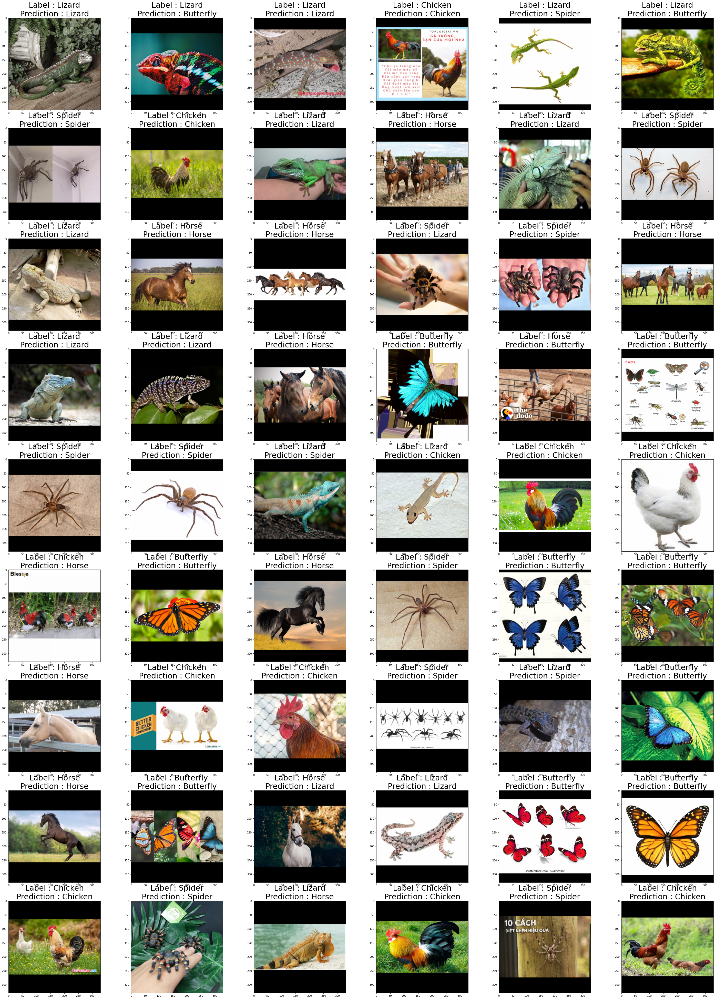

In [29]:
plot_image_label_predic(my_model)

In [30]:
pretrain_model = models.resnet34()
pretrain_model.fc = nn.Sequential(nn.Dropout(0.5),nn.Linear(512, 5))

path_model_pretrain = "mymodel_pretrain.pt"

if str(device) == "cpu":
  print("cpu")
  pretrain_model.to(device)
  pretrain_model.load_state_dict(torch.load(path_model_pretrain, map_location=device))
elif str(device) == "cuda":
  print("cuda")
  pretrain_model.load_state_dict(torch.load(path_model_pretrain))
  pretrain_model.to(device)

cpu


In [31]:
loop = tqdm(test_loader)
sum = 0
pretrain_model.eval()
for imgs, labels in loop:
  imgs = imgs.to(device)
  labels = labels.to(device)
  outputs = pretrain_model(imgs)
  _, preds = torch.max(outputs, 1)
  sum += (preds == labels).sum().item()
  print(f'Accuracy : {sum/number_test_image}')

  0%|          | 0/1 [00:00<?, ?it/s]

Accuracy : 0.9074074074074074


9


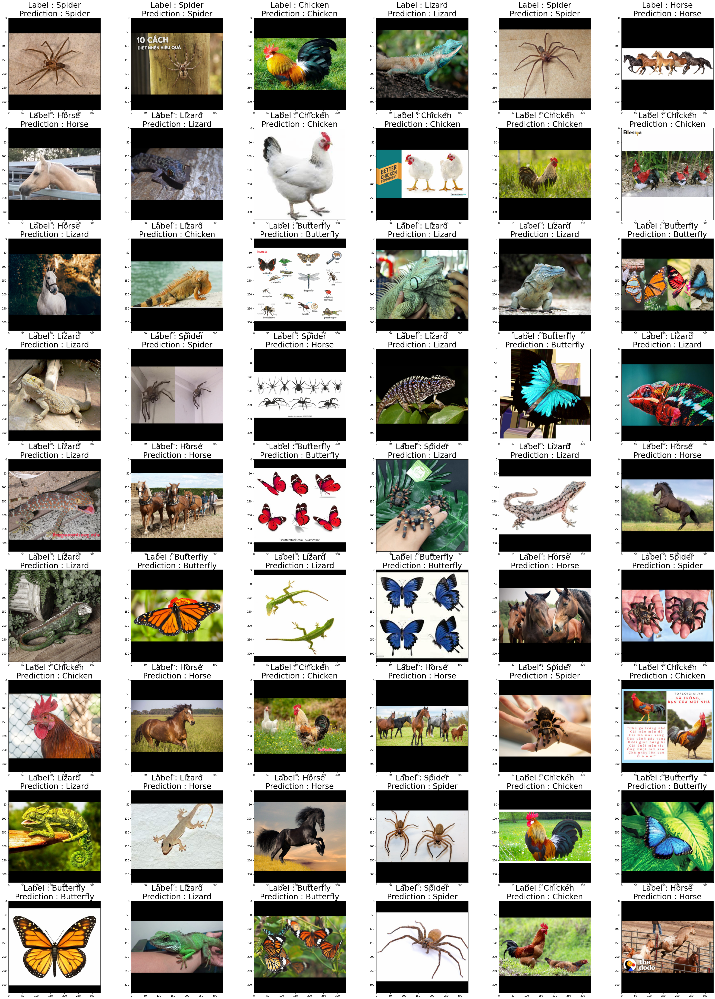

In [32]:
plot_image_label_predic(pretrain_model)